## Get the Data

Either use the provided .csv file or (optionally) get fresh (the freshest?) data from running an SQL query on StackExchange:

Follow this link to run the query from [StackExchange](https://data.stackexchange.com/stackoverflow/query/675441/popular-programming-languages-per-over-time-eversql-com) to get your own .csv file

<code>
select dateadd(month, datediff(month, 0, q.CreationDate), 0) m, TagName, count(*)
from PostTags pt
join Posts q on q.Id=pt.PostId
join Tags t on t.Id=pt.TagId
where TagName in ('java','c','c++','python','c#','javascript','assembly','php','perl','ruby','visual basic','swift','r','object-c','scratch','go','swift','delphi')
and q.CreationDate < dateadd(month, datediff(month, 0, getdate()), 0)
group by dateadd(month, datediff(month, 0, q.CreationDate), 0), TagName
order by dateadd(month, datediff(month, 0, q.CreationDate), 0)
</code>

## Import Statements

In [ ]:
import pandas as pd
pd.options.display.float_format = '{:,.2f}'.format

## Data Exploration

**Challenge**: Read the .csv file and store it in a Pandas dataframe

In [ ]:
# df = pd.read_csv('QueryResults.csv', names=['DATE', 'TAG', 'POSTS'], header=0)

df = pd.read_csv('QueryResults.csv')
df.columns = ['DATE', 'TAG', 'POSTS']

**Challenge**: Examine the first 5 rows and the last 5 rows of the of the dataframe

In [ ]:
df.head()

,DATE,TAG,POSTS
0,2008-07-01 00:00:00,c#,3
1,2008-08-01 00:00:00,assembly,8
2,2008-08-01 00:00:00,c,83
3,2008-08-01 00:00:00,c#,505
4,2008-08-01 00:00:00,c++,164


In [ ]:
df.tail()

,DATE,TAG,POSTS
2519,2023-09-01 00:00:00,php,1767
2520,2023-09-01 00:00:00,python,9063
2521,2023-09-01 00:00:00,r,2068
2522,2023-09-01 00:00:00,ruby,195
2523,2023-09-01 00:00:00,swift,910


**Challenge:** Check how many rows and how many columns there are.
What are the dimensions of the dataframe?

In [ ]:
df.shape

(2524, 3)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2524 entries, 0 to 2523
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   DATE    2524 non-null   object
 1   TAG     2524 non-null   object
 2   POSTS   2524 non-null   int64 
dtypes: int64(1), object(2)
memory usage: 59.3+ KB


**Challenge**: Count the number of entries in each column of the dataframe

In [ ]:
df.count()

DATE     2524
TAG      2524
POSTS    2524
dtype: int64

**Challenge**: Calculate the total number of post per language.
Which Programming language has had the highest total number of posts of all time?

In [ ]:
df.groupby('TAG')[['POSTS']].sum().sort_values('POSTS', ascending=False)

,POSTS
TAG,
javascript,2510463
python,2161324
java,1905860
c#,1602055
php,1460232
c++,799087
r,497212
c,399457
swift,330004


Some languages are older (e.g., C) and other languages are newer (e.g., Swift). The dataset starts in September 2008.

**Challenge**: How many months of data exist per language? Which language had the fewest months with an entry?


In [ ]:
df.groupby('TAG')[['DATE']].count()

,DATE
TAG,
assembly,182
c,182
c#,183
c++,182
delphi,182
go,167
java,182
javascript,182
perl,182


## Data Cleaning

Let's fix the date format to make it more readable. We need to use Pandas to change format from a string of "2008-07-01 00:00:00" to a datetime object with the format of "2008-07-01"

In [ ]:
df['DATE'] = pd.to_datetime(df['DATE'])
df[['DATE']]

,DATE
0,2008-07-01
1,2008-08-01
2,2008-08-01
3,2008-08-01
4,2008-08-01
...,...
2519,2023-09-01
2520,2023-09-01
2521,2023-09-01
2522,2023-09-01


## Data Manipulation



Sometimes you want to convert your DataFrame so that each category has its own column. For example, suppose you needed to take the table below and create a separate column for each actor, where each row is the Age of the actor:

![image.jpg](https://img-c.udemycdn.com/redactor/raw/2020-09-23_14-13-02-d87f678153b7f925e4fba57d50e6be42.png)

How would you do this with the DataFrame below?

In [ ]:
test_df = pd.DataFrame({'Age': ['Young', 'Young', 'Young', 'Young', 'Old', 'Old', 'Old', 'Old'],
                        'Actor': ['Jack', 'Arnold', 'Keanu', 'Sylvester', 'Jack', 'Arnold', 'Keanu', 'Sylvester'],
                        'Power': [100, 80, 25, 50, 99, 75, 5, 30]})
test_df

,Age,Actor,Power
0,Young,Jack,100
1,Young,Arnold,80
2,Young,Keanu,25
3,Young,Sylvester,50
4,Old,Jack,99
5,Old,Arnold,75
6,Old,Keanu,5
7,Old,Sylvester,30


The easiest way to accomplish this is by using the .pivot() method in Pandas. Try the example for yourself. The thing to understand is how to supply the correct aguments to get the desired outcome. The index are the categories for the rows. The columns are the categories for the columns. And the values are what you want in the new cells.

In [ ]:
pivoted_df = test_df.pivot(index='Age', columns='Actor', values='Power')
pivoted_df

Actor,Arnold,Jack,Keanu,Sylvester
Age,,,,
Old,75,99,5,30
Young,80,100,25,50


Mini-Challenge:

Can you pivot the df DataFrame so that each row is a date and each column is a programming language? Store the result under a variable called reshaped_df.

In [ ]:
reshaped_df = df.pivot(index='DATE', columns='TAG', values='POSTS')
reshaped_df

TAG,assembly,c,c#,c++,delphi,go,java,javascript,perl,php,python,r,ruby,swift
DATE,,,,,,,,,,,,,,
2008-07-01,NaN,NaN,3.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2008-08-01,8.00,83.00,505.00,164.00,14.00,NaN,222.00,163.00,28.00,158.00,120.00,NaN,70.00,NaN
2008-09-01,28.00,320.00,"1,640.00",755.00,104.00,NaN,"1,129.00",634.00,130.00,475.00,538.00,6.00,286.00,NaN
2008-10-01,16.00,303.00,"1,988.00",807.00,112.00,NaN,"1,149.00",722.00,128.00,610.00,506.00,NaN,247.00,NaN
2008-11-01,16.00,258.00,"1,731.00",734.00,141.00,NaN,955.00,580.00,97.00,499.00,449.00,1.00,157.00,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-05-01,174.00,"1,049.00","3,833.00","1,779.00",114.00,418.00,"4,175.00","7,768.00",54.00,"1,971.00","11,799.00","2,865.00",255.00,996.00
2023-06-01,155.00,890.00,"3,805.00","1,815.00",117.00,520.00,"4,295.00","7,526.00",54.00,"1,905.00","11,274.00","2,664.00",226.00,"1,132.00"
2023-07-01,162.00,917.00,"3,881.00","1,856.00",99.00,524.00,"4,072.00","7,546.00",69.00,"1,745.00","11,161.00","2,363.00",224.00,"1,157.00"


Examine the dimensions of the reshaped DataFrame. How many rows does it have? How many columns?

In [ ]:
reshaped_df.shape

(183, 14)

Examine the head and the tail of the DataFrame. What does it look like?

In [ ]:
reshaped_df.head()

TAG,assembly,c,c#,c++,delphi,go,java,javascript,perl,php,python,r,ruby,swift
DATE,,,,,,,,,,,,,,
2008-07-01,NaN,NaN,3.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2008-08-01,8.00,83.00,505.00,164.00,14.00,NaN,222.00,163.00,28.00,158.00,120.00,NaN,70.00,NaN
2008-09-01,28.00,320.00,"1,640.00",755.00,104.00,NaN,"1,129.00",634.00,130.00,475.00,538.00,6.00,286.00,NaN
2008-10-01,16.00,303.00,"1,988.00",807.00,112.00,NaN,"1,149.00",722.00,128.00,610.00,506.00,NaN,247.00,NaN
2008-11-01,16.00,258.00,"1,731.00",734.00,141.00,NaN,955.00,580.00,97.00,499.00,449.00,1.00,157.00,NaN


In [ ]:
reshaped_df.tail()

TAG,assembly,c,c#,c++,delphi,go,java,javascript,perl,php,python,r,ruby,swift
DATE,,,,,,,,,,,,,,
2023-05-01,174.00,"1,049.00","3,833.00","1,779.00",114.00,418.00,"4,175.00","7,768.00",54.00,"1,971.00","11,799.00","2,865.00",255.00,996.00
2023-06-01,155.00,890.00,"3,805.00","1,815.00",117.00,520.00,"4,295.00","7,526.00",54.00,"1,905.00","11,274.00","2,664.00",226.00,"1,132.00"
2023-07-01,162.00,917.00,"3,881.00","1,856.00",99.00,524.00,"4,072.00","7,546.00",69.00,"1,745.00","11,161.00","2,363.00",224.00,"1,157.00"
2023-08-01,144.00,870.00,"3,662.00","1,672.00",106.00,496.00,"3,849.00","6,823.00",48.00,"1,787.00","10,310.00","2,360.00",203.00,982.00
2023-09-01,161.00,903.00,"3,177.00","1,617.00",107.00,442.00,"3,519.00","5,969.00",63.00,"1,767.00","9,063.00","2,068.00",195.00,910.00


Print out the column names.

In [ ]:
reshaped_df.columns

Index(['assembly', 'c', 'c#', 'c++', 'delphi', 'go', 'java', 'javascript',
       'perl', 'php', 'python', 'r', 'ruby', 'swift'],
      dtype='object', name='TAG')

Count the number of entries per programming language. Why might the number of entries be different?

In [ ]:
reshaped_df.count()

TAG
assembly      182
c             182
c#            183
c++           182
delphi        182
go            167
java          182
javascript    182
perl          182
php           182
python        182
r             180
ruby          182
swift         174
dtype: int64

When we count the number of entries per column we see that not all languages are the same. The reason is that the .count() method excludes NaN values. When we pivoted the DataFrame the NaN values were inserted when there were no posts for a language in that month (e.g., Swift in July, 2008).

Make sure any NaN value is replaced.

In [ ]:
reshaped_df.fillna(0, inplace=True)
reshaped_df.head()

TAG,assembly,c,c#,c++,delphi,go,java,javascript,perl,php,python,r,ruby,swift
DATE,,,,,,,,,,,,,,
2008-07-01,0.00,0.00,3.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
2008-08-01,8.00,83.00,505.00,164.00,14.00,0.00,222.00,163.00,28.00,158.00,120.00,0.00,70.00,0.00
2008-09-01,28.00,320.00,"1,640.00",755.00,104.00,0.00,"1,129.00",634.00,130.00,475.00,538.00,6.00,286.00,0.00
2008-10-01,16.00,303.00,"1,988.00",807.00,112.00,0.00,"1,149.00",722.00,128.00,610.00,506.00,0.00,247.00,0.00
2008-11-01,16.00,258.00,"1,731.00",734.00,141.00,0.00,955.00,580.00,97.00,499.00,449.00,1.00,157.00,0.00


## Data Visualisation with Matplotlib


Without mathplotlib we can use the pandas .plot() method.

<Axes: xlabel='DATE'>

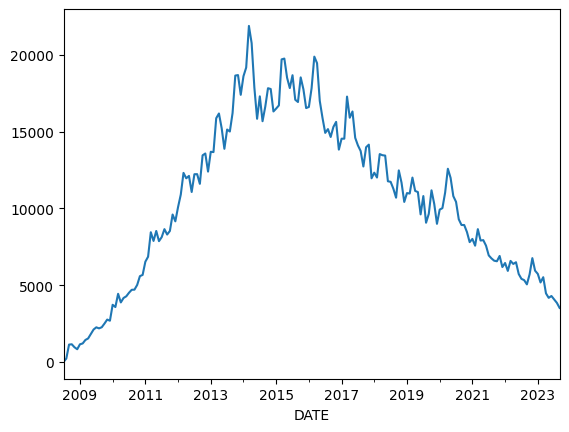

In [ ]:
reshaped_df['java'].plot()

**Challenge**: Use the [matplotlib documentation](https://matplotlib.org/3.2.1/api/_as_gen/matplotlib.pyplot.plot.html#matplotlib.pyplot.plot) to plot a single programming language (e.g., java) on a chart.

In [ ]:
import matplotlib.pyplot as plt

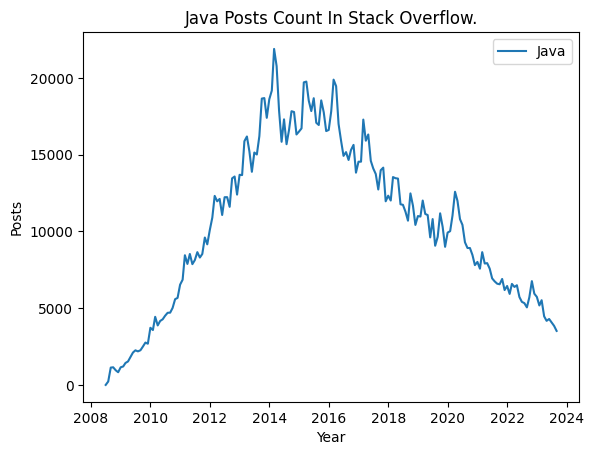

In [ ]:
plt.plot(reshaped_df.index, reshaped_df['java'], label='Java')
plt.legend()
plt.title('Java Posts Count In Stack Overflow.')
plt.xlabel('Year')
plt.ylabel('Posts')
plt.show()

All we have to do is supply the values for the horizontal axis (the x-values) and the vertical axis (the y-values) for the chart. The x-values are the dates and the y-values are the number of posts.

**Challenge**: Show two lines (e.g. for Java and Python) on the same chart.

Text(0, 0.5, 'Posts')

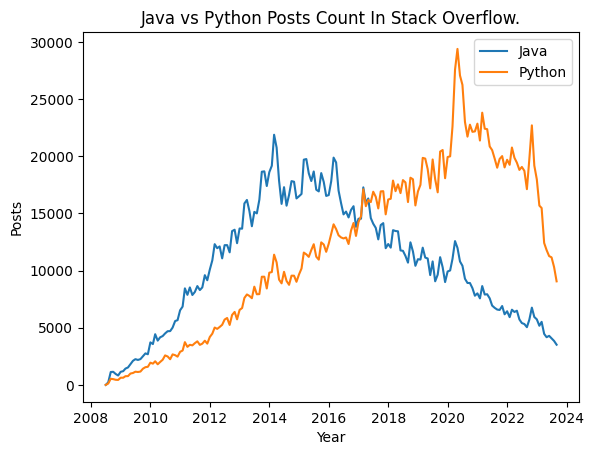

In [ ]:
# plt.plot(reshaped_df.index, reshaped_df['java'], label='Java')
# plt.plot(reshaped_df.index, reshaped_df['python'], label='Python')
plt.plot(reshaped_df.index, reshaped_df[['java', 'python']], label=['Java', 'Python'])
plt.legend()
plt.title('Java vs Python Posts Count In Stack Overflow.')
plt.xlabel('Year')
plt.ylabel('Posts')

**Challenge**: Show three lines (e.g. for Java vs Python vs Javascript) on the same chart.

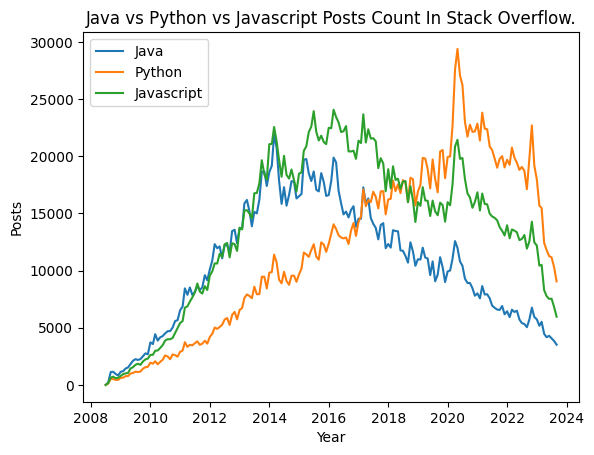

In [ ]:
plt.plot(reshaped_df.index, reshaped_df[['java', 'python', 'javascript']], label=['Java', 'Python', 'Javascript'])
plt.legend()
plt.title('Java vs Python vs Javascript Posts Count In Stack Overflow.')
plt.xlabel('Year')
plt.ylabel('Posts')
plt.show()

## Styling the Chart

Let's look at a couple of methods that will help us style our chart:

.figure() - allows us to resize our chart

.xticks() - configures our x-axis

.yticks() - configures our y-axis

.xlabel() - add text to the x-axis

.ylabel() - add text to the y-axis

.ylim() - allows us to set a lower and upper bound

To make our chart larger we can provide a width (16) and a height (10) as the figsize of the figure.

This will make our chart easier to see. But when we increase the size of the chart, we should also increase the fontsize of the ticks on our axes so that they remain easy to read.

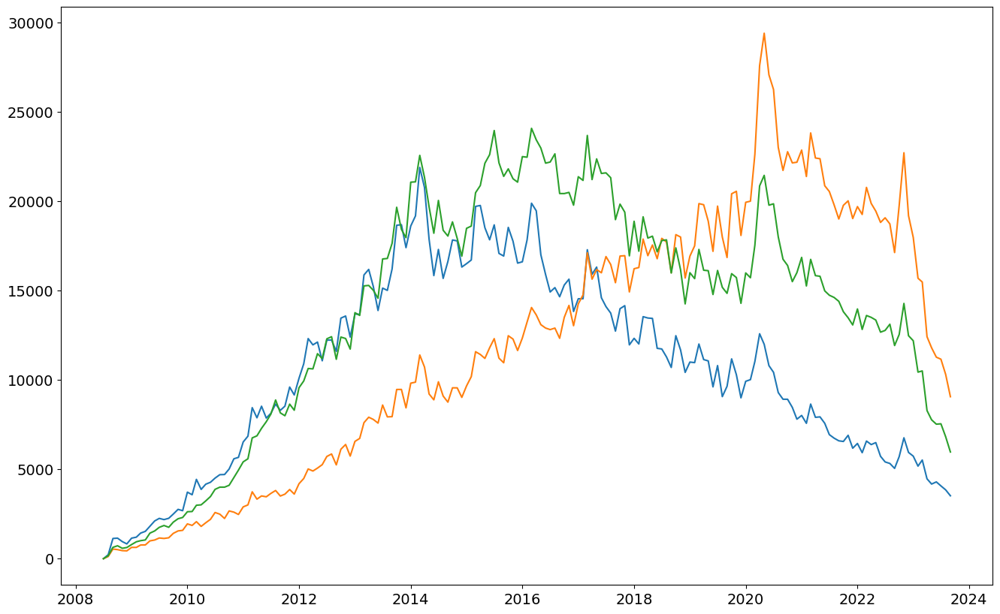

In [ ]:
plt.figure(figsize=(16, 10))
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.plot(reshaped_df.index, reshaped_df[['java', 'python', 'javascript']], label=['Java', 'Python', 'Javascript'])

Now we can add labels. Also, we're never going to get less than 0 posts, so let's set a lower limit of 0 for the y-axis with .ylim().

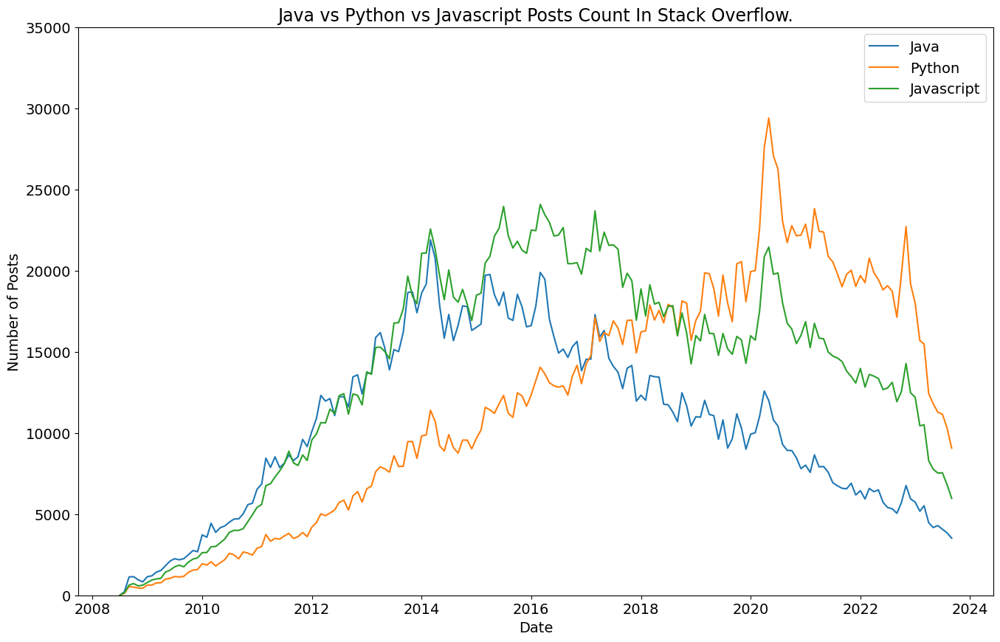

In [ ]:
plt.figure(figsize=(16, 10))
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.title('Java vs Python vs Javascript Posts Count In Stack Overflow.', fontsize=17)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Number of Posts', fontsize=14)
plt.ylim(0, 35000)
plt.plot(reshaped_df.index, reshaped_df[['java', 'python', 'javascript']], label=['Java', 'Python', 'Javascript'])
plt.legend(fontsize=14)
plt.show()

**Challenge**: Plot all the languages

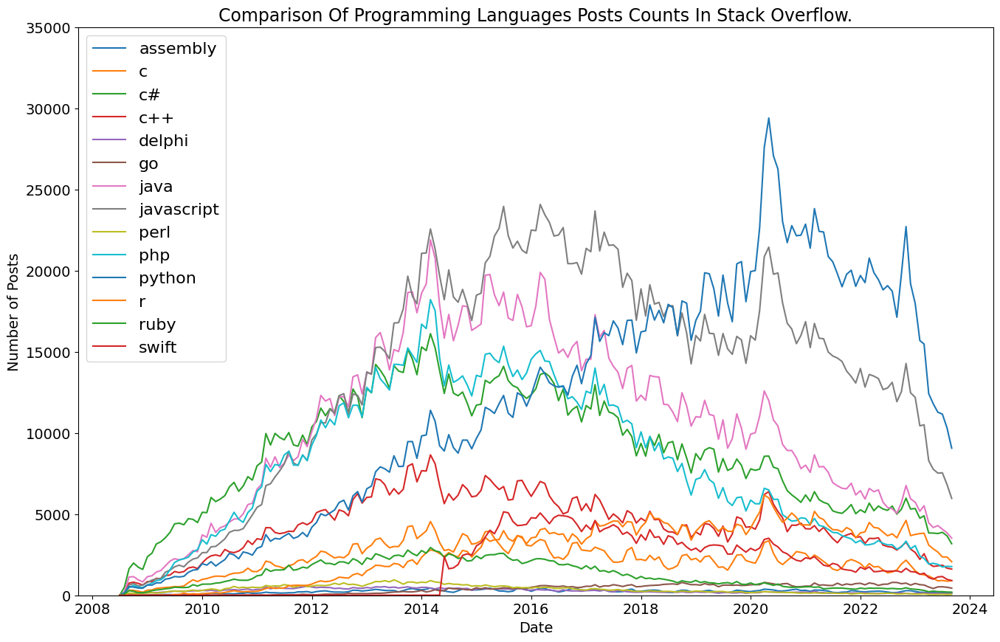

In [ ]:
plt.figure(figsize=(16,10))
plt.title('Comparison Of Programming Languages Posts Counts In Stack Overflow.', fontsize=17)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Number of Posts', fontsize=14)
plt.ylim(0, 35000)

for column in reshaped_df.columns:
    # plt.plot(reshaped_df.index, reshaped_df[column], linewidth=3, label=reshaped_df[column].name)
    plt.plot(reshaped_df.index, reshaped_df[column], label=reshaped_df[column].name)

plt.legend(fontsize=16)

# Smoothing out Time Series Data

Time series data can be quite noisy, with a lot of up and down spikes. To better see a trend we can plot an average of, say 6 or 12 observations. This is called the rolling mean. We calculate the average in a window of time and move it forward by one overservation. Pandas has two handy methods already built in to work this out: [rolling()](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.rolling.html) and [mean()](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.core.window.rolling.Rolling.mean.html).

Below we can see a comparison of the first 10 rows of the DataFrames without and with smoothing. With a window of size 6 we take batches of 6 values in a column and calculate the mean (the value on the 6th cell + the 5 previous values). The result value is put in the 6th cell of that column, and we proceed with the following cell and bunch.

Because of the windows size we see that the first 5 rows in the smoothed DataFrame show NaN values, as we need precisely 6 values to calculate the mean.

In [ ]:
# without smoothing
reshaped_df.head(10)

TAG,assembly,c,c#,c++,delphi,go,java,javascript,perl,php,python,r,ruby,swift
DATE,,,,,,,,,,,,,,
2008-07-01,0.00,0.00,3.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
2008-08-01,8.00,83.00,505.00,164.00,14.00,0.00,222.00,163.00,28.00,158.00,120.00,0.00,70.00,0.00
2008-09-01,28.00,320.00,"1,640.00",755.00,104.00,0.00,"1,129.00",634.00,130.00,475.00,538.00,6.00,286.00,0.00
2008-10-01,16.00,303.00,"1,988.00",807.00,112.00,0.00,"1,149.00",722.00,128.00,610.00,506.00,0.00,247.00,0.00
2008-11-01,16.00,258.00,"1,731.00",734.00,141.00,0.00,955.00,580.00,97.00,499.00,449.00,1.00,157.00,0.00
2008-12-01,17.00,188.00,"1,594.00",631.00,134.00,0.00,826.00,625.00,133.00,477.00,437.00,1.00,159.00,0.00
2009-01-01,22.00,318.00,"2,375.00",849.00,164.00,0.00,"1,148.00",790.00,146.00,630.00,631.00,8.00,205.00,1.00
2009-02-01,36.00,331.00,"2,599.00",842.00,167.00,0.00,"1,203.00",945.00,163.00,758.00,630.00,8.00,286.00,1.00
2009-03-01,24.00,430.00,"3,156.00","1,047.00",161.00,0.00,"1,430.00","1,007.00",137.00,895.00,764.00,4.00,329.00,1.00


In [ ]:
# with smoothing
rolling_df = reshaped_df.rolling(window=6).mean()
rolling_df.head(10)

TAG,assembly,c,c#,c++,delphi,go,java,javascript,perl,php,python,r,ruby,swift
DATE,,,,,,,,,,,,,,
2008-07-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2008-08-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2008-09-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2008-10-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2008-11-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2008-12-01,14.17,192.00,"1,243.50",515.17,84.17,0.00,713.50,454.00,86.00,369.83,341.67,1.33,153.17,0.00
2009-01-01,17.83,245.00,"1,638.83",656.67,111.50,0.00,904.83,585.67,110.33,474.83,446.83,2.67,187.33,0.17
2009-02-01,22.50,286.33,"1,987.83",769.67,137.00,0.00,"1,068.33",716.00,132.83,574.83,531.83,4.00,223.33,0.33
2009-03-01,21.83,304.67,"2,240.50",818.33,146.50,0.00,"1,118.50",778.17,134.00,644.83,569.50,3.67,230.50,0.50


Now we plot the smoothed DataFrame.

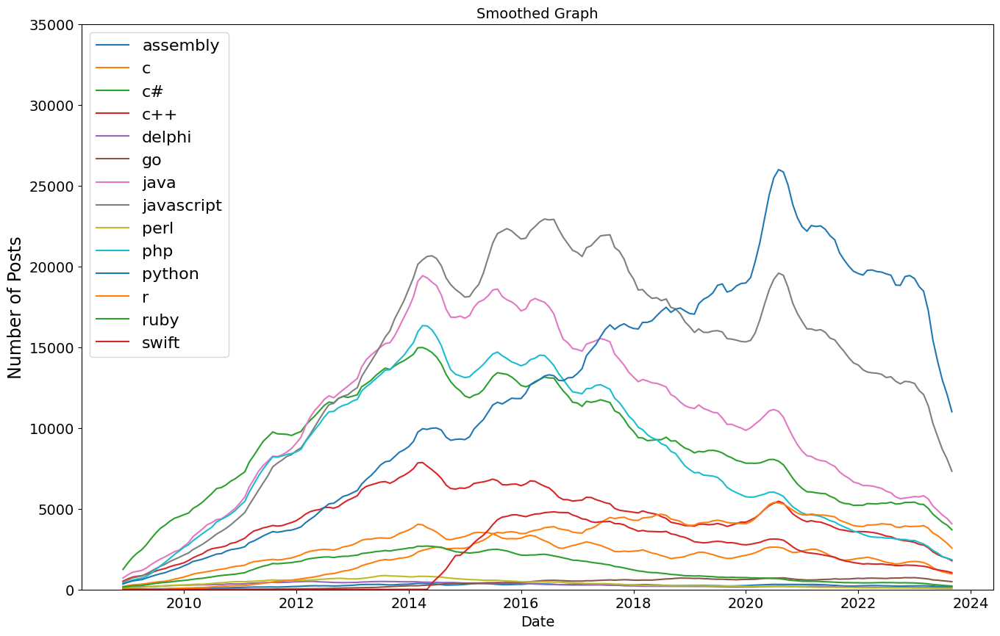

In [ ]:
plt.figure(figsize=(16, 10))
plt.title('Smoothed Graph', fontsize=14)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Number of Posts', fontsize=17)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.ylim(0, 35000)

for column in rolling_df.columns:
  plt.plot(rolling_df.index, rolling_df[column], label=column)
plt.legend(fontsize=16)

**Challenge**: Make and animated graph.

In [ ]:
import matplotlib.animation as animation
from IPython.display import HTML

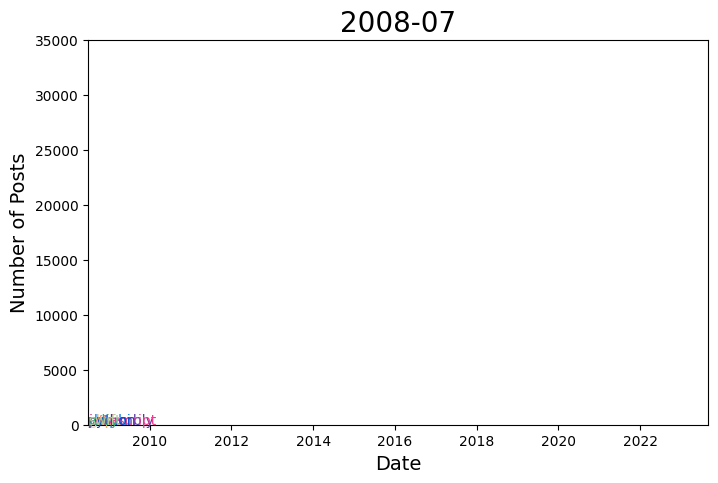

In [ ]:
fig, ax = plt.subplots(figsize=(8, 5))
colors = ['#5639A6', '#20236D', '#FA4848', '#FFE087', '#0779E4', '#EECCB4', '#77D8D8', '#F6378F', '#D83C65', '#F3A953', '#064ACB', '#604CC3', '#2AAF74', '#B5C99A']

def draw_frame(frame):
    frame_df = reshaped_df[reshaped_df.index <= frame]
    ax.clear()
    ax.set_xlabel('Date', fontsize=14)
    ax.set_ylabel('Number of Posts', fontsize=14)
    ax.set_ylim(0, 35000)
    ax.set_xlim(reshaped_df.index[0], reshaped_df.index[-1])
    ax.set_title(str(frame).split()[0][:7], fontsize=20)

    for column, color in zip(frame_df.columns, colors):
        ax.plot(frame_df.index, frame_df[column], label=frame_df[column].name, color=color)
        ax.text(x=frame_df.index[-1], y=frame_df[column][-1], s=column, color=color)


ani = animation.FuncAnimation(fig=fig, func=draw_frame, frames=reshaped_df.index)
# draw_frame(reshaped_df.index[19])
HTML(ani.to_jshtml())

## Questions

**Q1**: What was the most popular language between 2008 and 2012?

In [107]:
df.loc[df['DATE'] < '2013-01-01'].groupby('TAG')[['POSTS']].sum().sort_values('POSTS', ascending=False).head(1)

,POSTS
TAG,
c#,378780


**Q2**: What was the most popular language between 2015 and 2018?

In [117]:
df.loc[(df['DATE'] >= '2015-01-01') & (df['DATE'] < '2019-01-01')].groupby('TAG')[['POSTS']].sum().max()

POSTS    975563
dtype: int64

Alternative answers using the reshaped_df:

In [108]:
range_of_year = range(2015,2019)
reshaped_df.loc[reshaped_df.index.year.isin(range_of_year)].sum().idxmax()

'javascript'

In [109]:
reshaped_df['20150101':'20181230'].sum().idxmax()

'javascript'

**Q3**: What was the most popular programming language in 2020?

In [105]:
df.loc[(df['DATE'] >= '2020-01-01') & (df['DATE'] < '2021-01-01')].groupby('TAG')[['POSTS']].sum().sort_values('POSTS', ascending=False).head(1)

,POSTS
TAG,
python,284720


## Summary

Today we've seen how to grab some raw data and create some interesting charts using Pandas and Matplotlib. We've:

- used .groupby() to explore the number of posts and entries per programming language
- converted strings to Datetime objects with to_datetime() for easier plotting (or use parse_dates= when reading the file)
- reshaped our DataFrame by converting categories to columns using .pivot()
- used .count() and isna().values.any() to look for NaN values in our DataFrame, which we then replaced using .fillna()
- created (multiple) line charts using .plot() with a for-loop
- styled our charts by changing the size, the labels, and the upper and lower bounds of our axis.
- added a legend to tell apart which line is which by colour
- smoothed out our time-series observations with .rolling().mean() and plotted them to better identify trends over time.